In [12]:
! pip install kaggle

In [13]:
! mkdir ~/.kaggle

mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [14]:
! cp kaggle.json ~/.kaggle/

In [15]:
! chmod 600 ~/.kaggle/kaggle.json

In [16]:
! kaggle datasets download robikscube/textocr-text-extraction-from-images-dataset

textocr-text-extraction-from-images-dataset.zip: Skipping, found more recently modified local copy (use --force to force download)


In [17]:
!unzip textocr-text-extraction-from-images-dataset

Archive:  textocr-text-extraction-from-images-dataset.zip
replace TextOCR_0.1_train.json? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


In [18]:
import pandas as pd
import numpy as np

from glob import glob
from tqdm.notebook import tqdm

import matplotlib.pyplot as plt
from PIL import Image

plt.style.use('ggplot')

In [20]:
annot = pd.read_csv('/content/annot.csv')
imgs = pd.read_parquet('/content/img.parquet')
img_fns = glob('/content/train_val_images/train_images/*')

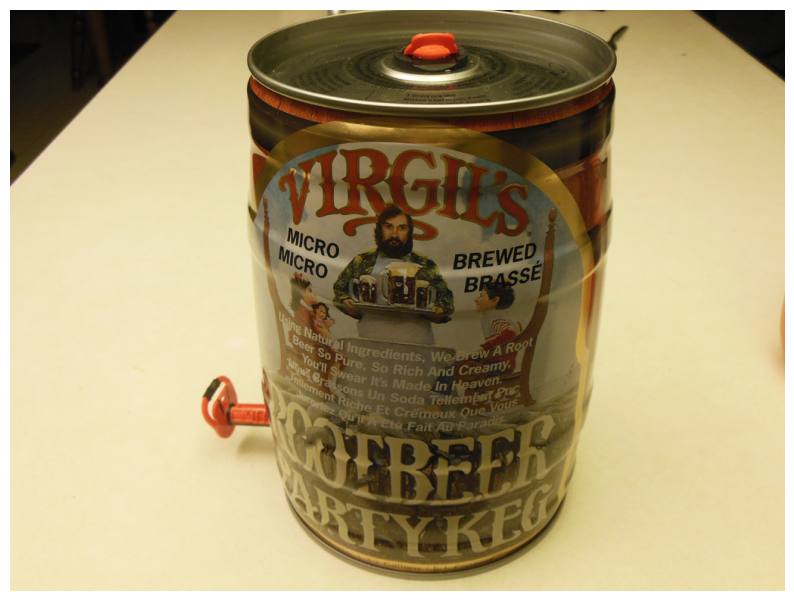

In [21]:
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(plt.imread(img_fns[12]))
ax.axis('off')
plt.show()

In [22]:
image_id = img_fns[0].split('/')[-1].split('.')[0]
annot.query('image_id == @image_id')

,Unnamed: 0,id,image_id,bbox,utf8_string,points,area
309789,309789,79049a2bd16e9ac6_1,79049a2bd16e9ac6,"[54.34, 41.34, 61.42, 29.54]",THIS,"[57.88, 41.34, 115.76, 42.53, 113.4, 70.88, 54...",1814.35
309790,309790,79049a2bd16e9ac6_2,79049a2bd16e9ac6,"[111.04, 40.16, 55.52, 34.26]",LIFE,"[113.4, 40.16, 166.56, 44.89, 165.38, 74.42, 1...",1902.12
309791,309791,79049a2bd16e9ac6_3,79049a2bd16e9ac6,"[570.55, 1.18, 185.45, 59.06]",START,"[572.91, 1.18, 753.64, 1.18, 756.0, 55.52, 570...",10952.68
309792,309792,79049a2bd16e9ac6_4,79049a2bd16e9ac6,"[751.28, 1.18, 118.12, 56.7]",THE,"[751.28, 1.18, 869.4, 2.36, 869.4, 53.16, 752....",6697.40
309793,309793,79049a2bd16e9ac6_5,79049a2bd16e9ac6,"[869.4, 0.0, 125.22, 54.34]",DAY,"[869.4, 0.0, 994.62, 1.18, 994.62, 50.79, 869....",6804.45
309794,309794,79049a2bd16e9ac6_6,79049a2bd16e9ac6,"[789.08, 64.97, 36.62, 33.07]",by,"[789.08, 66.15, 823.33, 64.97, 825.7, 98.04, 7...",1211.02
309795,309795,79049a2bd16e9ac6_7,79049a2bd16e9ac6,"[822.15, 61.43, 60.25, 34.25]",Rick,"[822.15, 67.33, 876.49, 61.43, 882.4, 92.14, 8...",2063.56
309796,309796,79049a2bd16e9ac6_8,79049a2bd16e9ac6,"[880.03, 62.61, 100.41, 29.53]",Brooket,"[880.03, 66.15, 980.44, 62.61, 979.26, 92.14, ...",2965.11
309797,309797,79049a2bd16e9ac6_9,79049a2bd16e9ac6,"[46.07, 79.14, 544.56, 94.5]",AAAACHOOOO!,"[59.06, 79.14, 590.63, 113.4, 585.9, 173.64, 4...",51460.92
309798,309798,79049a2bd16e9ac6_10,79049a2bd16e9ac6,"[394.54, 326.03, 60.24, 23.62]",DAILY,"[395.72, 326.03, 452.42, 326.03, 454.78, 349.6...",1422.87


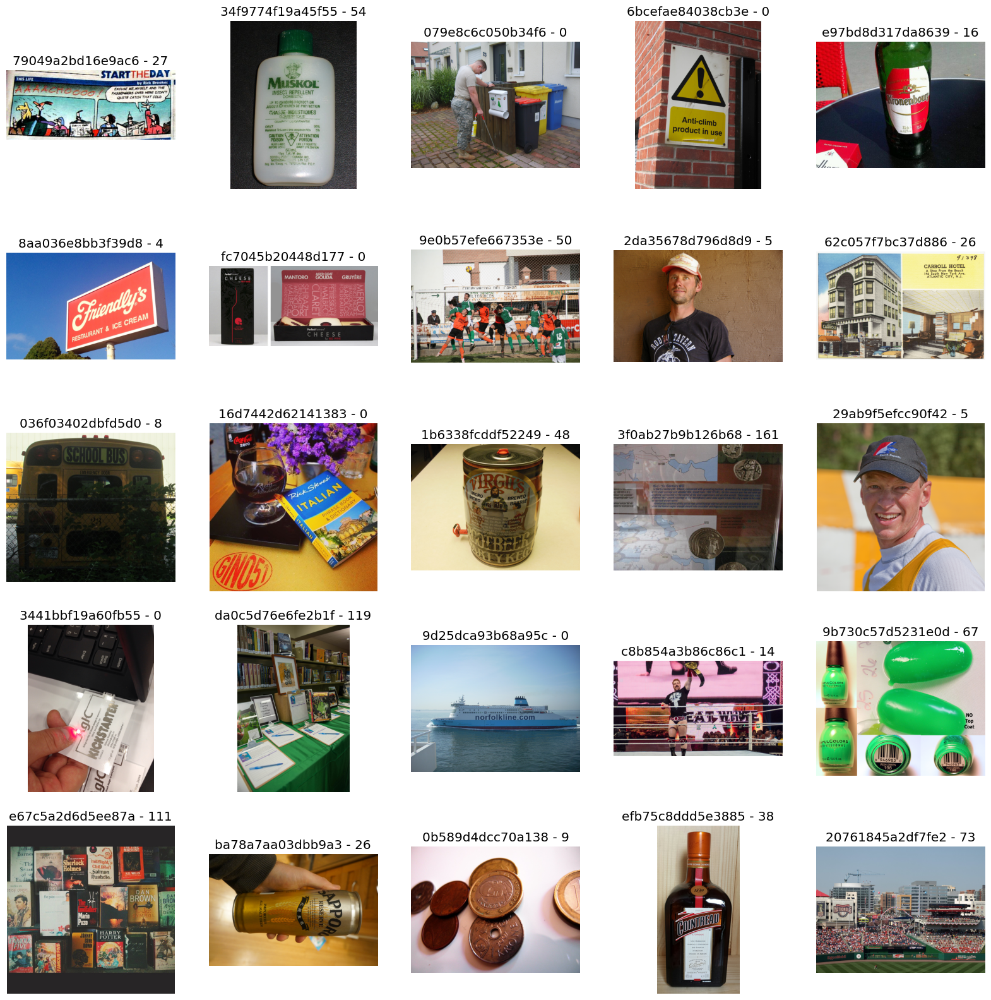

In [31]:
#Display first 25 images
fig, axs = plt.subplots(5, 5, figsize=(20, 20))
axs = axs.flatten()
for i in range(25):
    axs[i].imshow(plt.imread(img_fns[i]))
    axs[i].axis('off')
    image_id = img_fns[i].split('/')[-1].rstrip('.jpg')
    n_annot = len(annot.query('image_id == @image_id'))
    axs[i].set_title(f'{image_id} - {n_annot}')
plt.show()

In [33]:
!pip install easyocr

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 10.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 146.0/146.0 kB 13.4 MB/s eta 0:00:00


In [34]:
#Method 1 EasyOCR
import easyocr

reader = easyocr.Reader(['en'], gpu = True)

Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete

In [35]:
results = reader.readtext(img_fns[11])

In [36]:
pd.DataFrame(results, columns=['bbox','text','conf'])

,bbox,text,conf
0,"[[708, 572], [736, 572], [736, 598], [708, 598]]",8,0.445692
1,"[[688, 770], [712, 770], [712, 796], [688, 796]]",8o,0.215064
2,"[[0, 774], [400, 774], [400, 1024], [0, 1024]]",Gl15),0.189342
3,"[[135.8509805405407, 75.33803967567614], [268....",Gall,0.082989
4,"[[175.98198161801108, 122.78017977981217], [24...",Tero,0.890050
5,"[[467.1725097715042, 428.0490820806354], [737....",Pick Sleves,0.762488
6,"[[311.51341170750567, 373.6620705367551], [382...",Tlmn,0.005964
7,"[[517.9531521548196, 490.0549454707859], [796....",ITALIAN,0.998691
8,"[[352.1430466182295, 404.2572186472918], [406....",Kcd,0.011585
9,"[[782.8399704188685, 484.1719023822661], [864....",Book,0.807209


In [37]:
#Method 2 Keras-OCR
import keras_ocr

pipeline = keras_ocr.pipeline.Pipeline()

Looking for /root/.keras-ocr/craft_mlt_25k.h5
Looking for /root/.keras-ocr/crnn_kurapan.h5


In [38]:
results = pipeline.recognize([img_fns[11]])

1/1 [==============================] - 7s 7s/step


In [39]:
pd.DataFrame(results[0], columns=['text', 'bbox'])

,text,bbox
0,cac,"[[141.15967, 82.75751], [236.18298, 70.691055]..."
1,zero,"[[178.91866, 125.9325], [246.0577, 109.87751],..."
2,ricksieves,"[[473.19666, 431.59113], [731.1281, 307.69397]..."
3,italan,"[[524.5751, 501.54285], [788.05554, 350.65094]..."
4,raen,"[[272.0, 365.0], [382.0, 365.0], [382.0, 432.0..."
5,econ,"[[342.7117, 405.11697], [423.1207, 381.94827],..."
6,book,"[[787.83167, 488.319], [861.31165, 431.47598],..."
7,ricaseves,"[[413.96, 452.28003], [431.87997, 438.84003], ..."
8,dictionary,"[[729.5531, 566.16046], [883.57947, 453.82547]..."
9,phrase,"[[680.5332, 555.678], [783.8312, 490.9612], [7..."


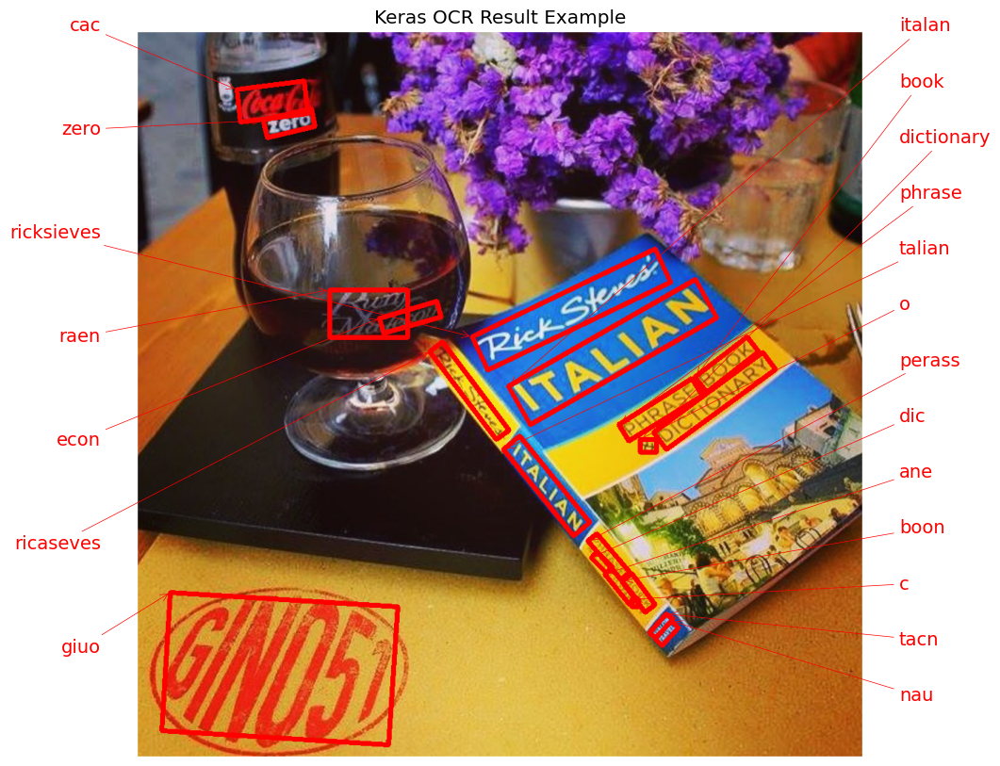

In [40]:
fig, ax = plt.subplots(figsize=(10, 10))
keras_ocr.tools.drawAnnotations(plt.imread(img_fns[11]), results[0], ax=ax)
ax.set_title('Keras OCR Result Example')
plt.show()

Comparing KerasOCR and EasyOCR

In [41]:
# easyocr
reader = easyocr.Reader(['en'], gpu = True)

dfs = []
for img in tqdm(img_fns[:25]):
    result = reader.readtext(img)
    img_id = img.split('/')[-1].split('.')[0]
    img_df = pd.DataFrame(result, columns=['bbox','text','conf'])
    img_df['img_id'] = img_id
    dfs.append(img_df)
easyocr_df = pd.concat(dfs)

100%|██████████| 25/25 [06:10<00:00, 14.81s/it]


In [42]:
# keras_ocr
pipeline = keras_ocr.pipeline.Pipeline()

dfs = []
for img in tqdm(img_fns[:25]):
    results = pipeline.recognize([img])
    result = results[0]
    img_id = img.split('/')[-1].split('.')[0]
    img_df = pd.DataFrame(result, columns=['text', 'bbox'])
    img_df['img_id'] = img_id
    dfs.append(img_df)
kerasocr_df = pd.concat(dfs)

Looking for /root/.keras-ocr/craft_mlt_25k.h5
Looking for /root/.keras-ocr/crnn_kurapan.h5


  0%|          | 0/25 [00:00<?, ?it/s]

1/1 [==============================] - 8s 8s/step


  4%|▍         | 1/25 [00:49<19:48, 49.52s/it]WARNING:tensorflow:5 out of the last 5 calls to <function Model.make_predict_function.<locals>.predict_function at 0x79587117a0e0> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.


2/2 [==============================] - 15s 6s/step


  8%|▊         | 2/25 [02:33<31:12, 81.40s/it]

1/1 [==============================] - 0s 435ms/step


 12%|█▏        | 3/25 [03:18<23:44, 64.76s/it]

1/1 [==============================] - 1s 837ms/step


 16%|█▌        | 4/25 [04:04<20:07, 57.49s/it]

1/1 [==============================] - 2s 2s/step


 20%|██        | 5/25 [04:52<18:04, 54.23s/it]

1/1 [==============================] - 2s 2s/step


 24%|██▍       | 6/25 [05:36<16:03, 50.73s/it]

2/2 [==============================] - 18s 2s/step


 28%|██▊       | 7/25 [06:38<16:18, 54.37s/it]

2/2 [==============================] - 7s 457ms/step


 32%|███▏      | 8/25 [08:11<18:51, 66.58s/it]

1/1 [==============================] - 1s 1s/step


 36%|███▌      | 9/25 [08:53<15:40, 58.76s/it]

1/1 [==============================] - 5s 5s/step


 40%|████      | 10/25 [09:39<13:44, 54.96s/it]

1/1 [==============================] - 2s 2s/step


 44%|████▍     | 11/25 [10:37<13:02, 55.88s/it]

1/1 [==============================] - 4s 4s/step


 48%|████▊     | 12/25 [12:04<14:09, 65.34s/it]

2/2 [==============================] - 11s 4s/step


 52%|█████▏    | 13/25 [13:12<13:12, 66.05s/it]

5/5 [==============================] - 36s 7s/step


 56%|█████▌    | 14/25 [15:16<15:19, 83.56s/it]

1/1 [==============================] - 2s 2s/step


 60%|██████    | 15/25 [16:40<13:57, 83.77s/it]

2/2 [==============================] - 10s 3s/step


 64%|██████▍   | 16/25 [18:13<12:59, 86.56s/it]

1/1 [==============================] - 6s 6s/step


 68%|██████▊   | 17/25 [19:41<11:37, 87.15s/it]

1/1 [==============================] - 1s 694ms/step


 72%|███████▏  | 18/25 [21:05<10:01, 85.95s/it]

1/1 [==============================] - 1s 1s/step


 76%|███████▌  | 19/25 [21:48<07:18, 73.01s/it]

1/1 [==============================] - 6s 6s/step


 80%|████████  | 20/25 [23:16<06:27, 77.60s/it]

3/3 [==============================] - 18s 5s/step


 84%|████████▍ | 21/25 [24:56<05:37, 84.43s/it]

1/1 [==============================] - 5s 5s/step


 88%|████████▊ | 22/25 [25:41<03:37, 72.58s/it]

1/1 [==============================] - 1s 1s/step


 92%|█████████▏| 23/25 [27:05<02:31, 75.93s/it]

1/1 [==============================] - 7s 7s/step


 96%|█████████▌| 24/25 [27:53<01:07, 67.71s/it]

1/1 [==============================] - 4s 4s/step


100%|██████████| 25/25 [28:45<00:00, 69.00s/it]


Plot Results: easyocr vs keras_ocr

In [43]:
def plot_compare(img_fn, easyocr_df, kerasocr_df):
    img_id = img_fn.split('/')[-1].split('.')[0]
    fig, axs = plt.subplots(1, 2, figsize=(15, 10))

    easy_results = easyocr_df.query('img_id == @img_id')[['text','bbox']].values.tolist()
    easy_results = [(x[0], np.array(x[1])) for x in easy_results]
    keras_ocr.tools.drawAnnotations(plt.imread(img_fn),
                                    easy_results, ax=axs[0])
    axs[0].set_title('easyocr results', fontsize=24)

    keras_results = kerasocr_df.query('img_id == @img_id')[['text','bbox']].values.tolist()
    keras_results = [(x[0], np.array(x[1])) for x in keras_results]
    keras_ocr.tools.drawAnnotations(plt.imread(img_fn),
                                    keras_results, ax=axs[1])
    axs[1].set_title('keras_ocr results', fontsize=24)
    plt.show()

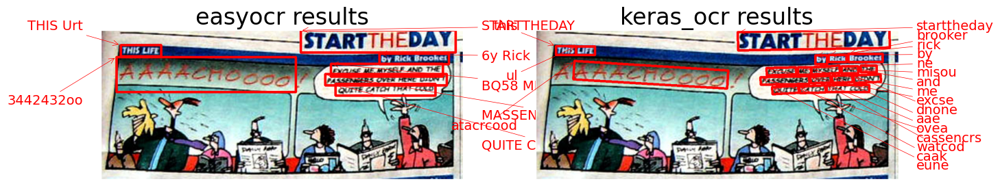

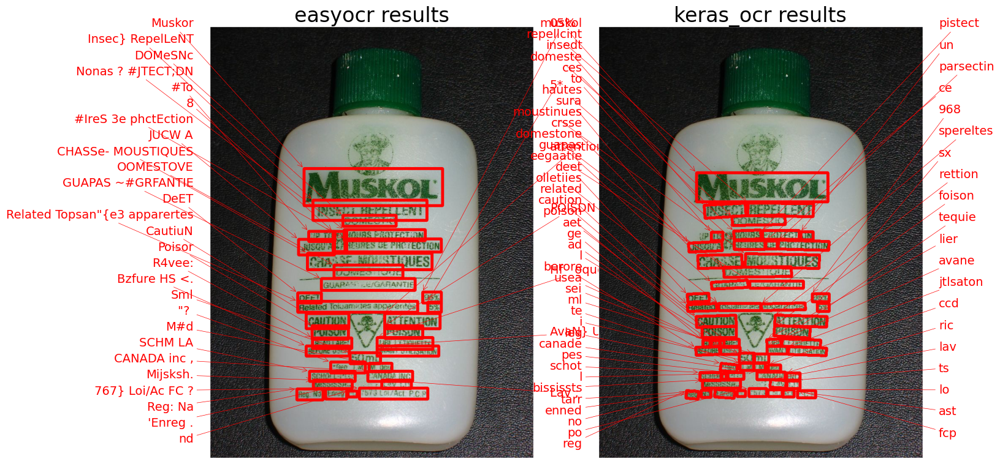

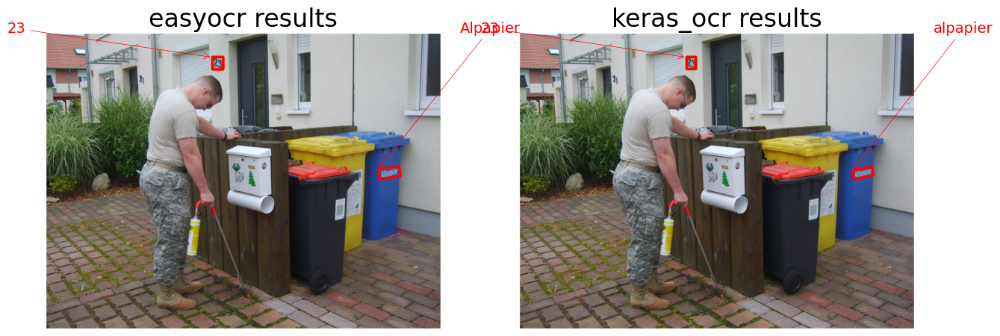

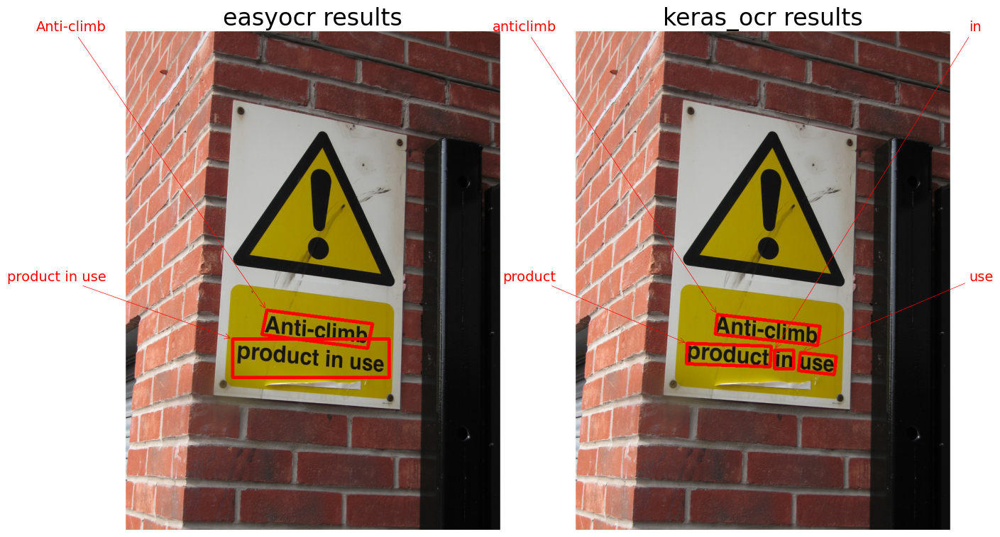

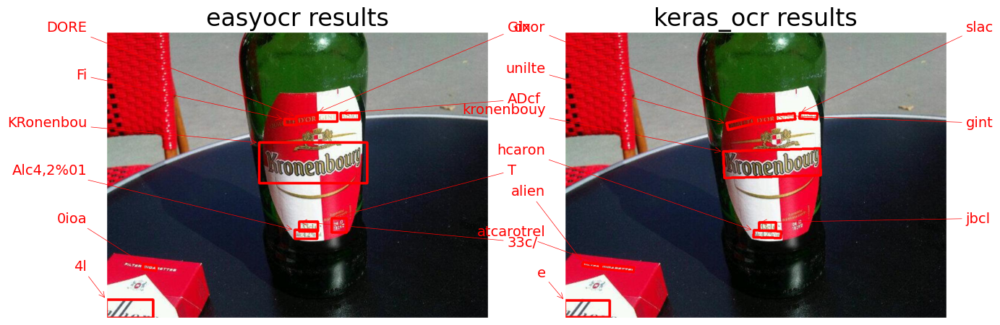

...

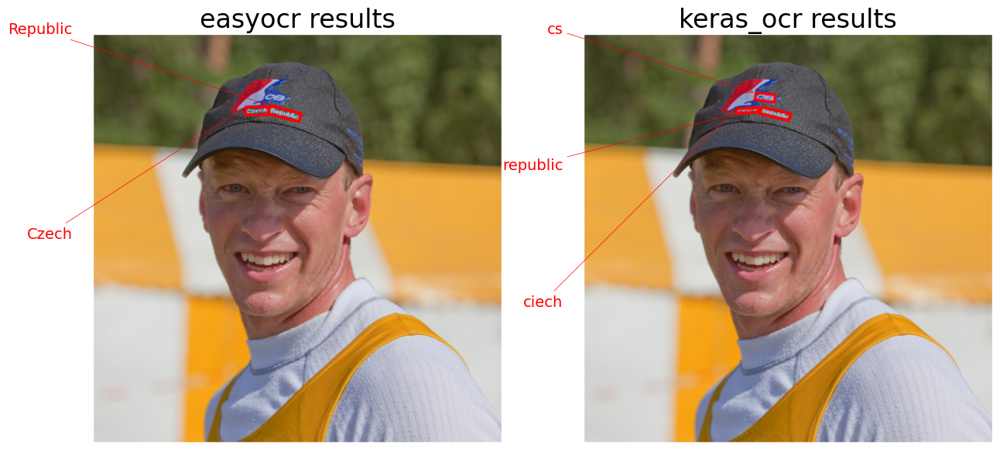

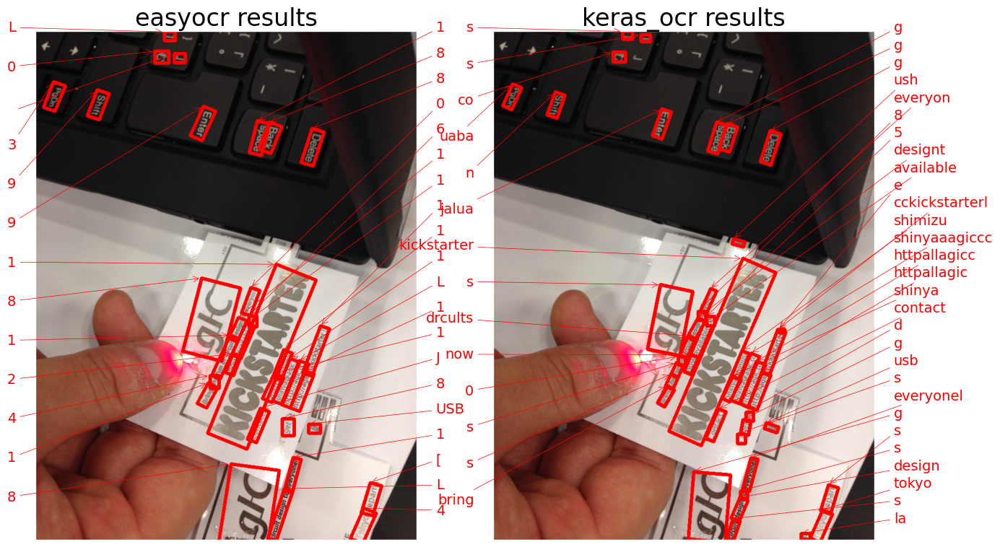

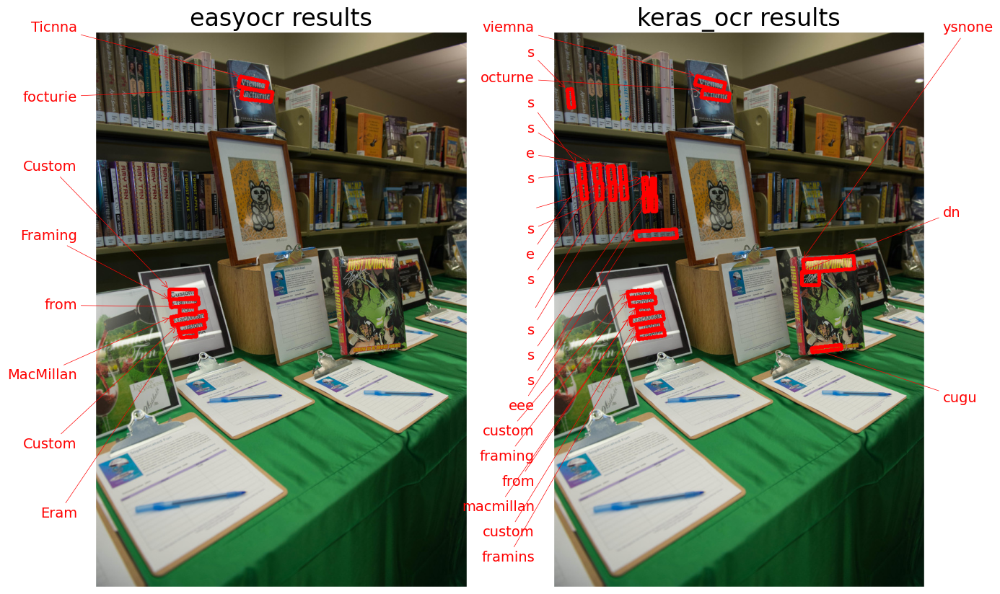

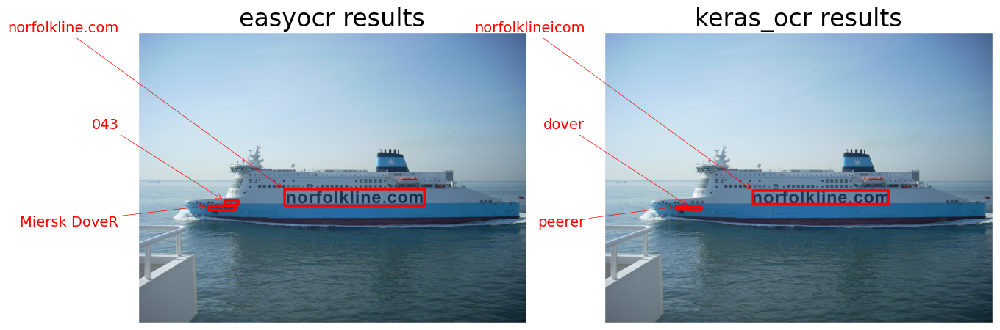

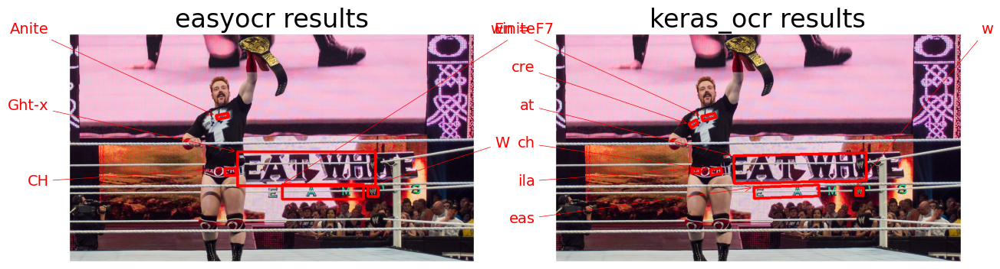

ValueError: ignored

<Figure size 1500x1000 with 2 Axes>

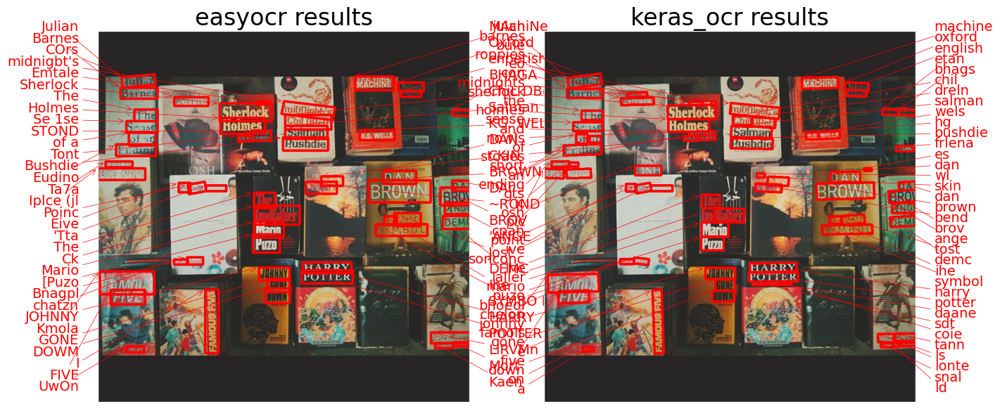

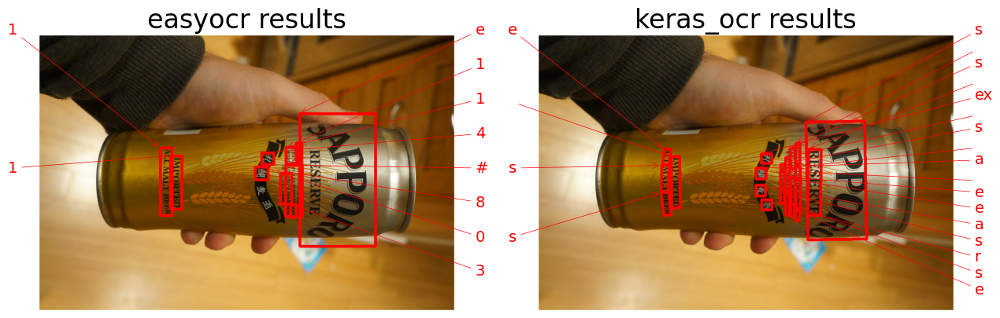

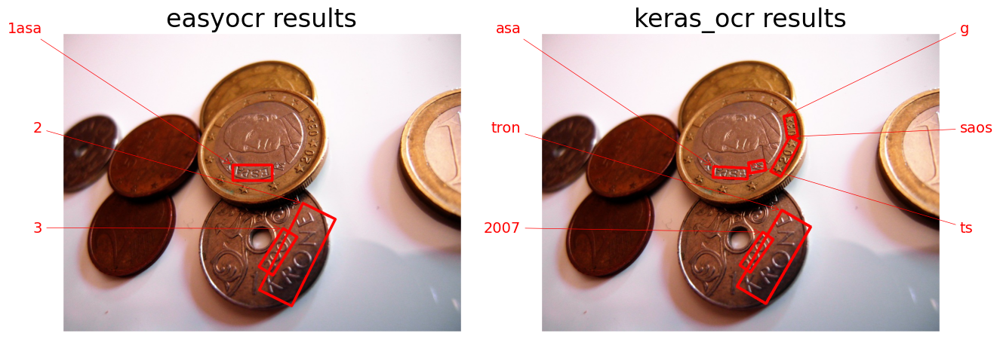

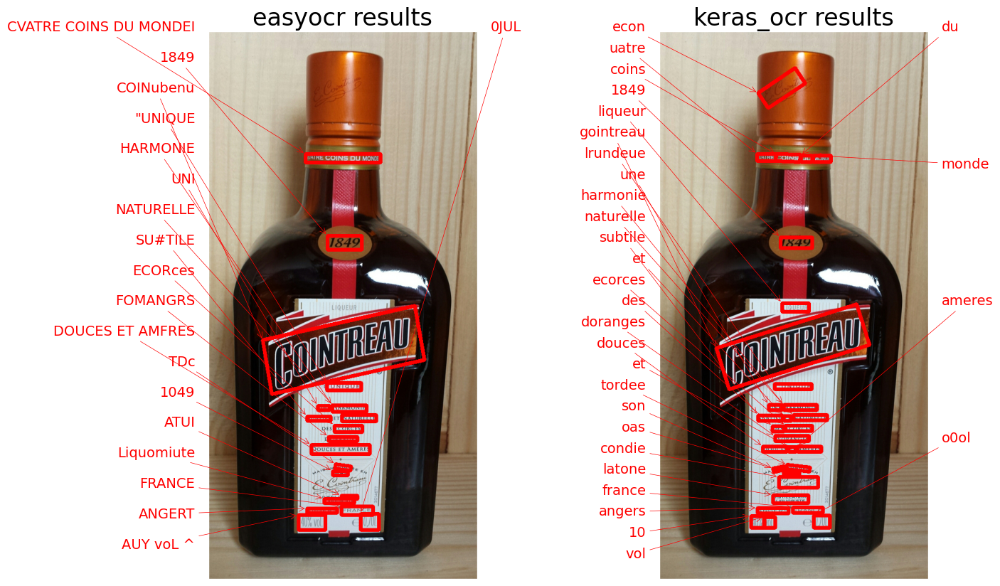

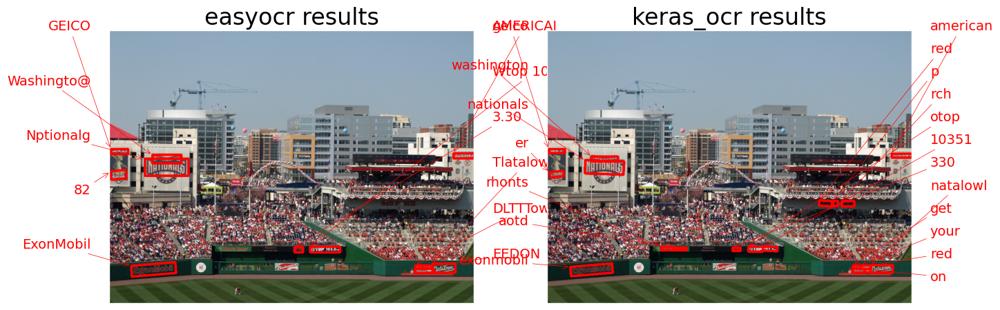

In [44]:
# Loop over results
for img_fn in img_fns[:25]:
    plot_compare(img_fn, easyocr_df, kerasocr_df)